# This dataset contains 433 images with bounding box annotations of the car license plates within the image. Our goal here is to train a convolutional neural network capable of locating licenses plate on new images. 

## Importing Libraries

In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import cv2
import os
import glob
from lxml import etree
from keras.models import Sequential
from keras.layers import GlobalAveragePooling2D
from keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Dropout
from sklearn.model_selection import train_test_split 
from tensorflow.keras import callbacks
from PIL import Image
from matplotlib.image import imread

# printing the full path of each file present in the directory

In [2]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/car-plate-detection/annotations/Cars339.xml
/kaggle/input/car-plate-detection/annotations/Cars13.xml
/kaggle/input/car-plate-detection/annotations/Cars74.xml
/kaggle/input/car-plate-detection/annotations/Cars16.xml
/kaggle/input/car-plate-detection/annotations/Cars291.xml
/kaggle/input/car-plate-detection/annotations/Cars236.xml
/kaggle/input/car-plate-detection/annotations/Cars429.xml
/kaggle/input/car-plate-detection/annotations/Cars132.xml
/kaggle/input/car-plate-detection/annotations/Cars251.xml
/kaggle/input/car-plate-detection/annotations/Cars51.xml
/kaggle/input/car-plate-detection/annotations/Cars165.xml
/kaggle/input/car-plate-detection/annotations/Cars313.xml
/kaggle/input/car-plate-detection/annotations/Cars240.xml
/kaggle/input/car-plate-detection/annotations/Cars201.xml
/kaggle/input/car-plate-detection/annotations/Cars412.xml
/kaggle/input/car-plate-detection/annotations/Cars227.xml
/kaggle/input/car-plate-detection/annotations/Cars145.xml
/kaggle/input/car-


# Defining model parameters

In [3]:
image_size=200
batch_size=32
epochs=50

# Creating the variable X containing all the images of cars by resizing them to 200 * 200

In [4]:
img_dir = "../input/car-plate-detection/images" 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)

files.sort() 
X=[]
for f1 in files:
    img = cv2.imread(f1)
    img = cv2.resize(img, (image_size,image_size))
    X.append(np.array(img))
    

# Creating variable y to contain all the bounding boxes annotations (label) 

In [5]:
# This function resizes the bounding box coordinates in an annotation file to match the specified IMAGE_SIZE
def resize_annotation(f):
    tree = etree.parse(f)
    for dim in tree.xpath("size"):
        width = int(dim.xpath("width")[0].text)
        height = int(dim.xpath("height")[0].text)
    for dim in tree.xpath("object/bndbox"):
        x_min = int(dim.xpath("xmin")[0].text)/(width/image_size)
        y_min = int(dim.xpath("ymin")[0].text)/(height/image_size)
        x_max = int(dim.xpath("xmax")[0].text)/(width/image_size)
        y_max = int(dim.xpath("ymax")[0].text)/(height/image_size)
        
    return [int(x_max), int(y_max), int(x_min), int(y_min)]
        

In [6]:
## This code reads in a list of annotation files, 
#resizes the bounding box coordinates for each file using the `resize_annotation` function, 
#and stores the resulting resized bounding box coordinates in a list called `y`.

path = '../input/car-plate-detection/annotations'
text_files = ['../input/car-plate-detection/annotations/'+f for f in sorted(os.listdir(path))]
y=[]
for i in text_files:
    y.append(resize_annotation(i))

In [7]:
#Calling
resize_annotation("/kaggle/input/car-plate-detection/annotations/Cars147.xml")

[168, 126, 90, 93]

In [8]:
y[0]

[167, 129, 90, 93]

# Cheking X , y shapes

In [9]:
np.array(X).shape

(433, 200, 200, 3)

In [10]:
np.array(y).shape

(433, 4)

# Displaying some images from dataset


In [11]:
print("Number of images:", len(X))

Number of images: 433


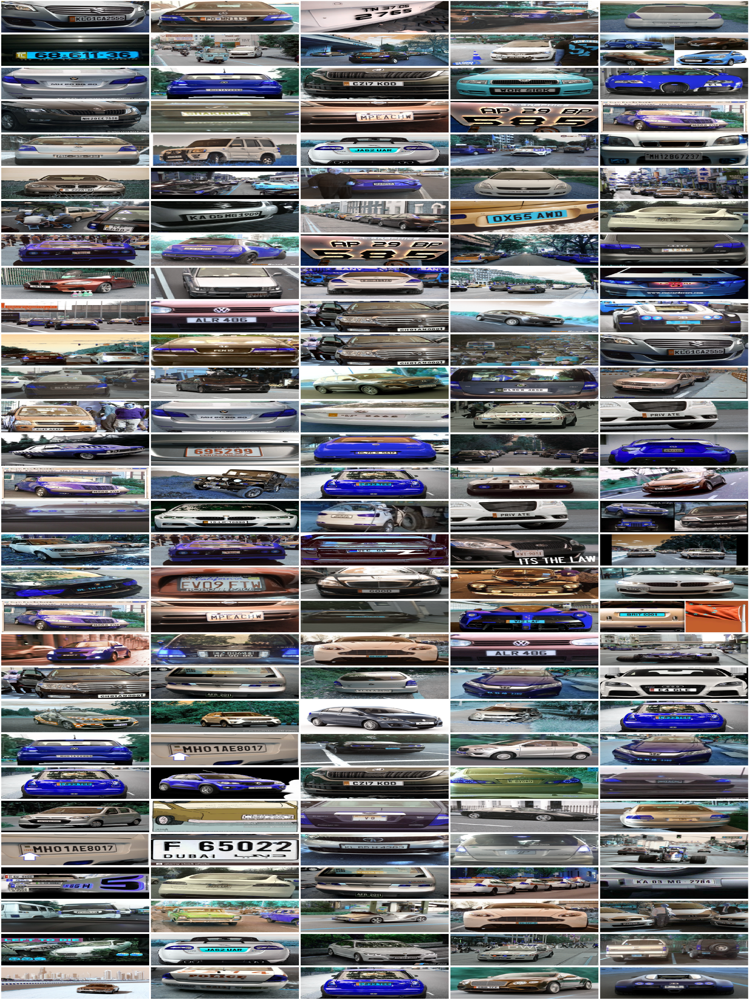

In [12]:

fig, axs = plt.subplots(nrows=30, ncols=5, figsize=(60, 80))

for i, ax in enumerate(axs.flatten()):
    if i < len(X):
        ax.set_axis_off()
        ax.imshow(X[i],interpolation='nearest',aspect='auto')
    else:
        break

plt.tight_layout()
plt.show()

# Drawing a rectangle around the first image in the X list using the bounding box coordinates from the first element of the y list

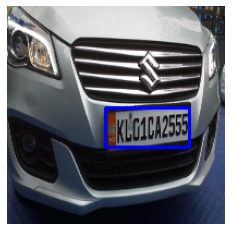

In [13]:
# Get the first image in X and its corresponding bounding box coordinates from y
image = X[0]
bbox = y[0]

# Draw a rectangle on the image using the bounding box coordinates
image = cv2.rectangle(image, (bbox[0], bbox[1]), (bbox[2], bbox[3]), (0, 0, 255), thickness=2)

# Display the resulting image
plt.imshow(image)
plt.axis('off')
plt.show()

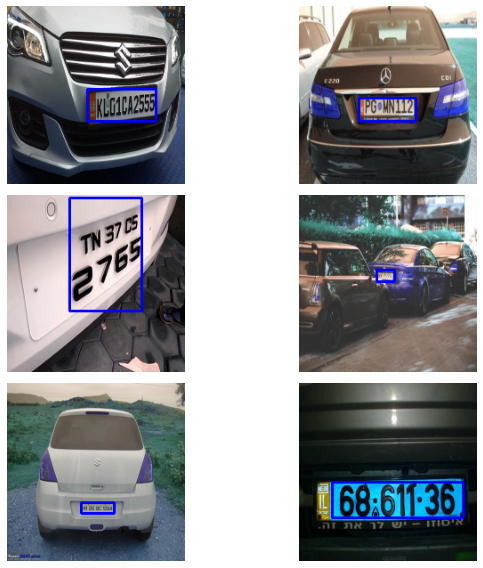

In [14]:
# Draw the bounding box on the license plate in each image and store in a list
images_with_bbox = []
for i in range(len(X)):

    plate_bbox = y[i][0:4]
    image_with_bbox = X[i].copy()

    # Draw the bounding box on the license plate 
    cv2.rectangle(image_with_bbox, (plate_bbox[0], plate_bbox[1]), (plate_bbox[2], plate_bbox[3]), (0, 0, 255), 2)
    images_with_bbox.append(image_with_bbox)

# Display the images with the bounding box 
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(10, 8))

for i, ax in enumerate(axs.flatten()):
    if i < len(images_with_bbox):
        ax.set_axis_off()
        ax.imshow(images_with_bbox[i])
    else:
        break

plt.tight_layout()
plt.show()

# Image Preprocessing:

In [15]:
#Transforming in array
X=np.array(X)
y=np.array(y)

In [16]:
X

array([[[[142, 115,  60],
         [162, 127,  47],
         [173, 147,  90],
         ...,
         [ 38,  39,  38],
         [ 44,  43,  42],
         [ 37,  36,  34]],

        [[132, 110,  58],
         [155, 121,  41],
         [141, 117,  65],
         ...,
         [ 49,  50,  50],
         [ 46,  47,  44],
         [ 36,  38,  35]],

        [[132, 114,  69],
         [154, 123,  45],
         [144, 126,  80],
         ...,
         [ 39,  39,  40],
         [ 50,  49,  46],
         [ 36,  37,  33]],

        ...,

        [[ 39,  47,  70],
         [ 40,  48,  71],
         [ 41,  49,  72],
         ...,
         [ 42,  61,  98],
         [ 46,  66, 100],
         [ 47,  68, 101]],

        [[ 43,  51,  74],
         [ 42,  50,  73],
         [ 40,  48,  71],
         ...,
         [ 44,  63, 100],
         [ 46,  65, 102],
         [ 48,  67, 104]],

        [[ 44,  52,  75],
         [ 41,  49,  72],
         [ 37,  45,  68],
         ...,
         [ 45,  64, 102],
        

In [17]:
y

array([[167, 129,  90,  93],
       [131, 129,  67, 103],
       [151, 131,  70,   4],
       ...,
       [148, 127,  49,  68],
       [133, 129,  45,  98],
       [139, 108,  37,  79]])

In [18]:
#Scaling
X = X / 255
y = y / 255

# splitting

In [19]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=1)

# Using a pretrained model and finetuning it

In [20]:
# Create the model
model = Sequential()
# Add a VGG16 convolutional base with pre-trained weights
model.add(VGG16(weights="imagenet", include_top=False, input_shape=(image_size, image_size, 3)))


model.add(Flatten())
model.add(Dense(128, activation="relu"))
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))

# Adding a final output layer 
model.add(Dense(4, activation="sigmoid"))

model.layers[-6].trainable = False


58892288/58889256 [==============================] - 2s 0us/step


In [21]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 6, 6, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 18432)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               2359424   
_________________________________________________________________
dense_1 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_2 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 260       
Total params: 17,099,140
Trainable params: 2,384,452
Non-trainable params: 14,714,688
____________________________________

In [22]:
#Compiling
model.compile(loss='mean_squared_error', 
             optimizer=Adam(lr=1e-4),
              metrics=['accuracy'])

In [23]:
early_stop=callbacks.EarlyStopping(patience=20,monitor='val_loss')

In [24]:
train = model.fit(X_train, y_train,
                  validation_data=(X_test, y_test),
                  epochs=epochs,
                  batch_size=batch_size,
                  callbacks=[early_stop],
                  verbose=1)

Epoch 1/50
13/13 [==============================] - 2s 120ms/step - loss: 0.0174 - accuracy: 0.5990 - val_loss: 0.0107 - val_accuracy: 0.6818
Epoch 2/50
13/13 [==============================] - 1s 57ms/step - loss: 0.0094 - accuracy: 0.7635 - val_loss: 0.0083 - val_accuracy: 0.7955
Epoch 3/50
13/13 [==============================] - 1s 59ms/step - loss: 0.0061 - accuracy: 0.8303 - val_loss: 0.0067 - val_accuracy: 0.7955
Epoch 4/50
13/13 [==============================] - 1s 58ms/step - loss: 0.0038 - accuracy: 0.8792 - val_loss: 0.0061 - val_accuracy: 0.7727
Epoch 5/50
13/13 [==============================] - 1s 57ms/step - loss: 0.0026 - accuracy: 0.8740 - val_loss: 0.0056 - val_accuracy: 0.7500
Epoch 6/50
13/13 [==============================] - 1s 58ms/step - loss: 0.0019 - accuracy: 0.9229 - val_loss: 0.0056 - val_accuracy: 0.8409
Epoch 7/50
13/13 [==============================] - 1s 57ms/step - loss: 0.0014 - accuracy: 0.9229 - val_loss: 0.0053 - val_accuracy: 0.8182
Epoch 8/50
1

In [25]:
# Test
scores = model.evaluate(X_test, y_test, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

Score : 81.82%


In [26]:
_, accuracy_train = model.evaluate(X_train,y_train)
_, accuracy_test = model.evaluate(X_test,y_test)

print('Accuracy for training: %.2f' % (accuracy_train*100))
print('Accuracy for testing: %.2f' % (accuracy_test*100))

2/2 [==============================] - 0s 15ms/step - loss: 0.0046 - accuracy: 0.8182
Accuracy for training: 93.83
Accuracy for testing: 81.82


In [27]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()

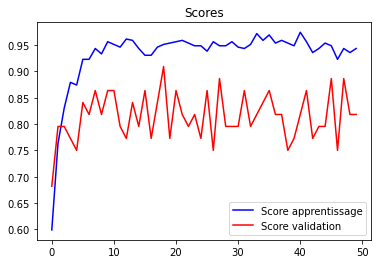

In [28]:
plot_scores(train)

## DETECTION 

In [29]:
 y_cnn = model.predict(X_test)

In [30]:
y_cnn[1].shape

(4,)

In [31]:
y_cnn

array([[0.42186362, 0.48235574, 0.24547395, 0.4187158 ],
       [0.53286624, 0.38070777, 0.28310144, 0.24677512],
       [0.5025731 , 0.4893427 , 0.26566803, 0.3800954 ],
       [0.6958736 , 0.54857314, 0.14480515, 0.11746684],
       [0.4454982 , 0.45709193, 0.3231429 , 0.4072982 ],
       [0.5712422 , 0.5554203 , 0.45379493, 0.5438619 ],
       [0.3643411 , 0.69590527, 0.1758416 , 0.5939579 ],
       [0.21499157, 0.5505555 , 0.09032673, 0.47266528],
       [0.4464062 , 0.63452697, 0.2757923 , 0.55453414],
       [0.45410883, 0.5715029 , 0.3210374 , 0.53279674],
       [0.7672904 , 0.5080085 , 0.64180154, 0.48804584],
       [0.637417  , 0.54662573, 0.43205318, 0.47708824],
       [0.41624215, 0.6017109 , 0.35274008, 0.57075834],
       [0.6576839 , 0.582706  , 0.37771434, 0.43233204],
       [0.4345727 , 0.4295484 , 0.3252827 , 0.4113889 ],
       [0.4721685 , 0.54323095, 0.41656318, 0.5490042 ],
       [0.7792181 , 0.74079794, 0.5322199 , 0.63622624],
       [0.3916065 , 0.45467559,

# Displaying Some predicted images with bounding box

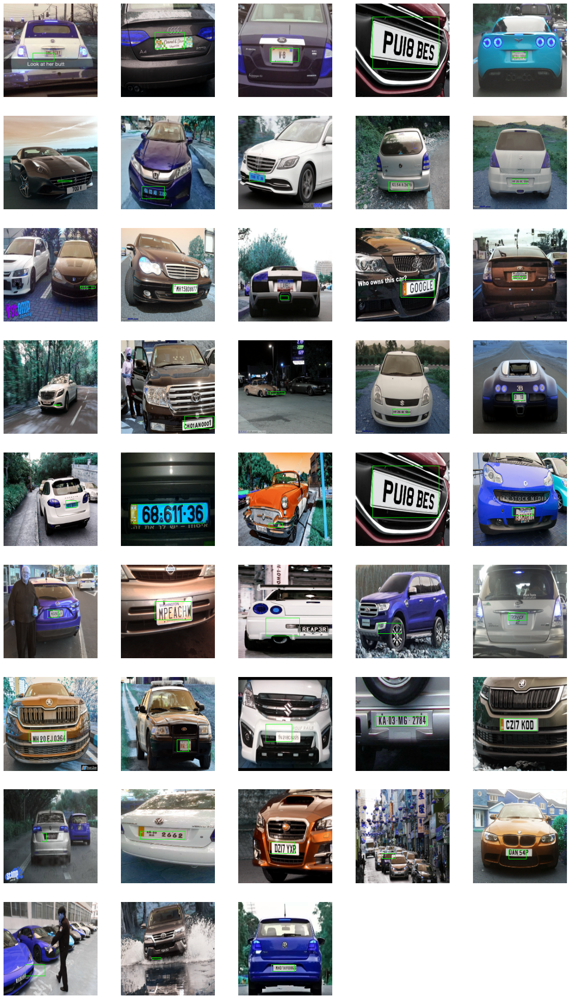

In [32]:

plt.figure(figsize=(20,40))
for i in range(0,43) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i],(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))
    plt.imshow(image)



# Displaying the images with their bounding box values

Image 0: (107, 123), (62, 106)
Image 1: (135, 97), (72, 62)
Image 2: (128, 124), (67, 96)
Image 3: (177, 139), (36, 29)
Image 4: (113, 116), (82, 103)
Image 5: (145, 141), (115, 138)
Image 6: (92, 177), (44, 151)
Image 7: (54, 140), (23, 120)
Image 8: (113, 161), (70, 141)
Image 9: (115, 145), (81, 135)
Image 10: (195, 129), (163, 124)
Image 11: (162, 139), (110, 121)
Image 12: (106, 153), (89, 145)
Image 13: (167, 148), (96, 110)
Image 14: (110, 109), (82, 104)
Image 15: (120, 138), (106, 139)
Image 16: (198, 188), (135, 162)
Image 17: (99, 115), (62, 110)
Image 18: (113, 159), (76, 147)
Image 19: (108, 129), (84, 112)
Image 20: (154, 118), (132, 103)
Image 21: (176, 151), (22, 111)
Image 22: (94, 160), (65, 151)
Image 23: (177, 139), (36, 29)
Image 24: (127, 135), (83, 117)
Image 25: (116, 113), (93, 97)
Image 26: (149, 118), (72, 79)
Image 27: (130, 152), (58, 114)
Image 28: (97, 147), (47, 125)
Image 29: (113, 119), (75, 103)
Image 30: (130, 136), (54, 114)
Image 31: (144, 158), (1

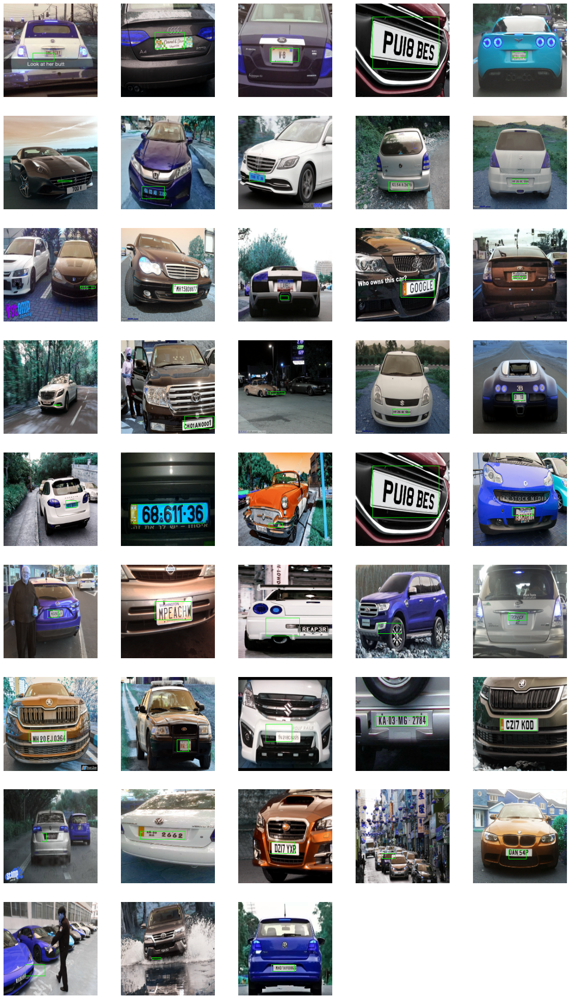

In [33]:
plt.figure(figsize=(20,40))
for i in range(0,43):
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i],(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))
    plt.imshow(image)
    
    # Print the bounding box values for the current image
    print(f"Image {i}: ({int(ny[0])}, {int(ny[1])}), ({int(ny[2])}, {int(ny[3])})")

# And with their corresponding indices

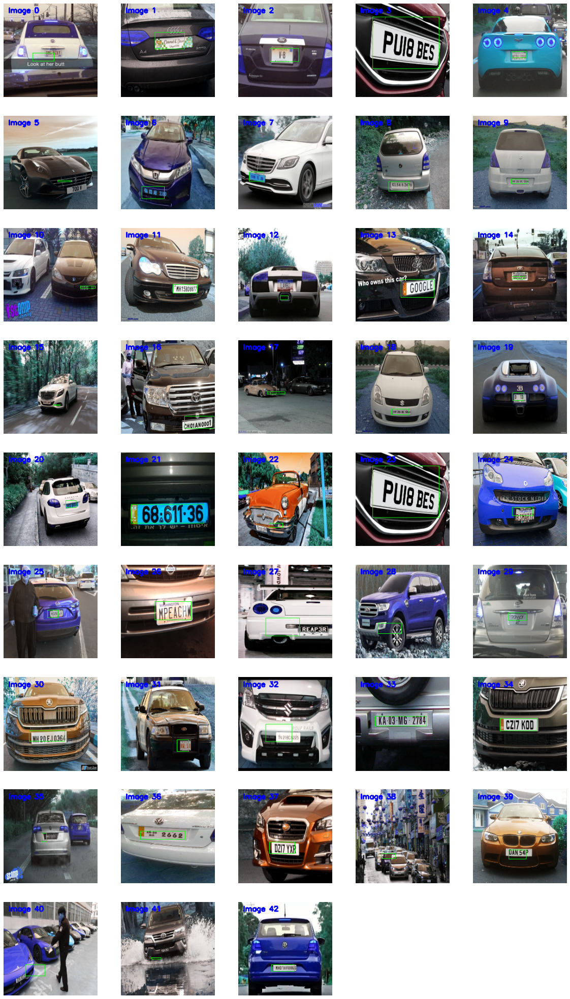

In [35]:
plt.figure(figsize=(20,40))
for i in range(0,43) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i],(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))
    image = cv2.putText(image, f"Image {i}", (10, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
    plt.imshow(image)

# Display the image you want by its index

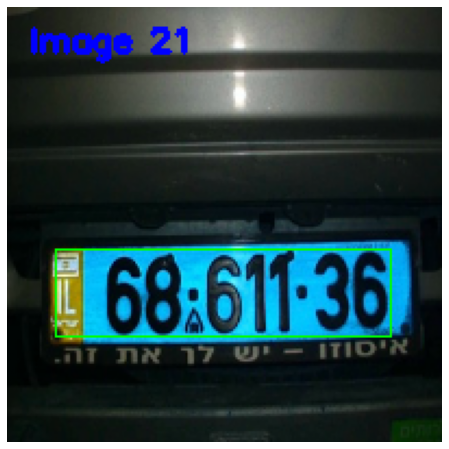

In [36]:
image_index =21 # Change this to the index of the image you want to visualize

ny = y_cnn[image_index]*255
image = cv2.rectangle(X_test[image_index],(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))

plt.figure(figsize=(8,8))
plt.imshow(image)
plt.axis('off')
plt.show()

# Enter image path that you want to make a prediction on!

# And now you can use  'easyocr 'to extract the text from the license plate and make it a machine readable text!

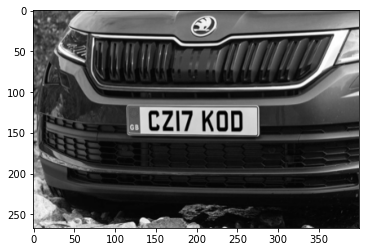

In [39]:
img = cv2.imread("/kaggle/input/car-plate-detection/images/Cars109.png")
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
plt.imshow(cv2.cvtColor(gray,cv2.COLOR_BGR2RGB))

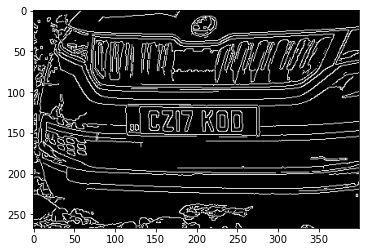

In [40]:
bfilter = cv2.bilateralFilter(gray, 11, 17, 17) #Noise reduction
edged = cv2.Canny(bfilter, 30, 200) #Edge detection
plt.imshow(cv2.cvtColor(edged, cv2.COLOR_BGR2RGB))

In [44]:
import imutils

In [45]:
keypoints = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contourss = imutils.grab_contours(keypoints)
contours = sorted(contourss, key=cv2.contourArea, reverse=True)[:10]
#print(contours)
len(contours)

10

In [47]:
location = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 10, True)
    if len(approx) == 4:
        location = approx
        break
len(location)        

4

In [49]:
location

array([[[130, 120]],

       [[273, 119]],

       [[274, 152]],

       [[133, 151]]], dtype=int32)

In [50]:
approx[1][0][0]

273

In [51]:
mask = np.zeros(gray.shape, np.uint8)
new_image = cv2.drawContours(mask, [location], -1,255, -1)
new_image = cv2.bitwise_and(img, img, mask=mask)

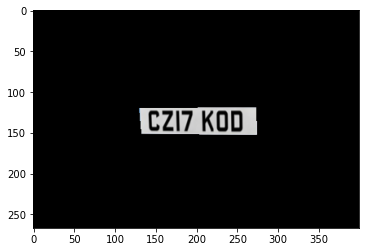

In [52]:
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))

In [ ]:
import numpy as np
(x,y) = np.where(mask==255)
(x1, y1) = (np.min(x), np.min(y))
(x2, y2) = (np.max(x), np.max(y))
cropped_image = gray[x1:x2+1, y1:y2+1]


In [ ]:
import cv2
cv2.imshow('Cropped Image', cropped_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Print the bounding box values for the current image
print(f"Bounding box values: ({int(ny[0])}, {int(ny[1])}), ({int(ny[2])}, {int(ny[3])})")